# DSLab initial exploration
---

In [1]:
import numpy as np
import cv2 as cv
import nd2
import matplotlib.pyplot as plt
import sys

In [2]:
from skimage import exposure
from skimage.filters import rank, median
from skimage.filters.rank import mean_bilateral
from skimage.morphology import disk

In [3]:
from scipy.ndimage import gaussian_filter
from skimage import data
from skimage import img_as_float
from skimage.morphology import reconstruction

In [4]:
from skimage import color, morphology

In [5]:
import sys
sys.executable

'/Users/antoine/miniconda3/envs/dsl/bin/python'

In [6]:
%matplotlib notebook

---
## Reading the data

In [7]:
def get_image_as_ndarray(frames, channels, path_to_image, allFrames = True, allChannels = False):


    f = nd2.ND2File(path_to_image)

    nr_frames = f.sizes['T']
    nr_channels = f.sizes['C']
    nr_rows = f.sizes['Y']
    nr_cols = f.sizes['X']

    print('Nr frames: ' + str(nr_frames))
    print('Nr channels: ' + str(nr_channels))
    print('Image dimensions: ' + str(nr_rows) + 'x' + str(nr_cols))


    channel_idx_lookup = {}
    if allChannels:
        channels = []
    print('Channel names:')
    for c in f.metadata.channels:
        channelname = c.channel.name
        if allChannels:
            channels.append(channelname)
        print('\t' + channelname)
        channelidx = c.channel.index
        if (channelname in channels):
            channel_idx_lookup[channelname] = channelidx
    channel_idx_precompute = []
    for ch_name in channels:
        channel_idx_precompute.append(channel_idx_lookup[ch_name])
    if allFrames:
        frames = range(nr_frames)
    fullimage = f.asarray()
    output = (fullimage[frames, :, :, :])[:, channel_idx_precompute, :, :]
    return output

In [8]:
data_dir = "../data/images"

In [9]:
image_path = data_dir + "/Small mvt 1.nd2"

In [10]:
image = get_image_as_ndarray([0], ['BF'], image_path, allFrames=True, allChannels=True)

Nr frames: 8
Nr channels: 5
Image dimensions: 4564x4650
Channel names:
	DAPI
	FITC
	TRITC
	Cy5
	BF


In [11]:
image.shape

(8, 5, 4564, 4650)

---
## Histogram equalization

In [12]:
img = image[0][4]

In [13]:
min_val = np.min(img)
max_val = np.max(img)

In [14]:
new_img = (img - min_val) * (256 / max_val)

In [15]:
new_img_int = new_img.astype(np.uint8)

<IPython.core.display.Javascript object>


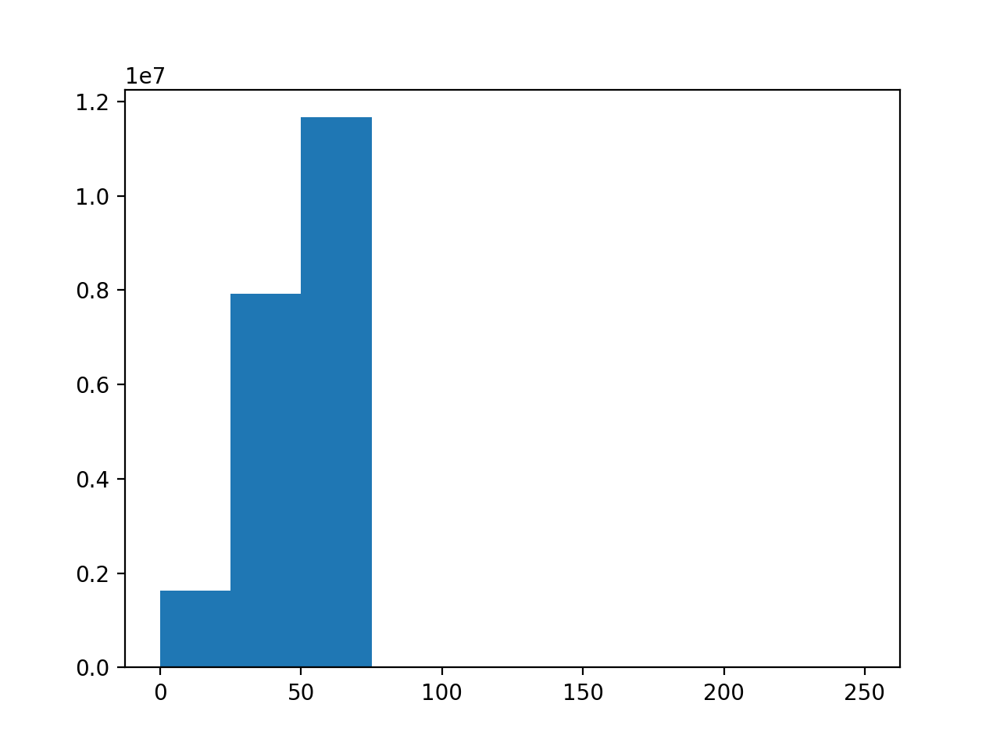

(array([1.6297640e+06, 7.9275760e+06, 1.1658201e+07, 6.8450000e+03,
        1.4100000e+02, 4.3000000e+01, 1.4000000e+01, 9.0000000e+00,
        5.0000000e+00, 2.0000000e+00]),
 array([  0.,  25.,  50.,  75., 100., 125., 150., 175., 200., 225., 250.]),
 <BarContainer object of 10 artists>)

In [16]:
plt.hist(new_img_int.ravel())

<IPython.core.display.Javascript object>


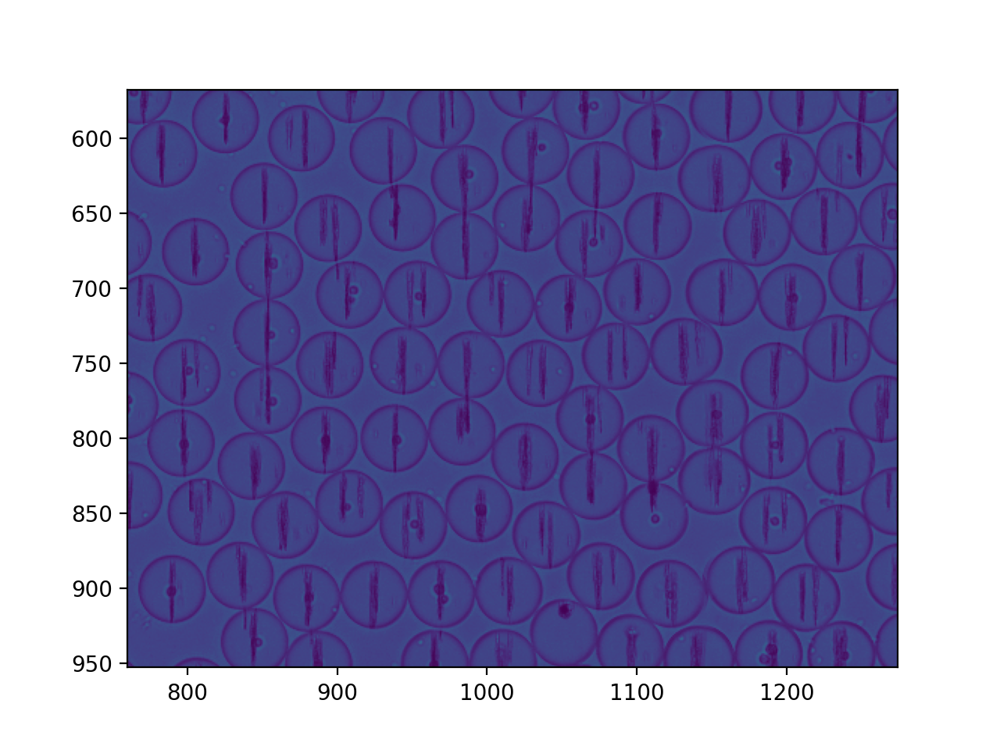

In [63]:
plt.imshow(new_img_int)

In [18]:
img_eq = cv.equalizeHist(new_img_int)

<IPython.core.display.Javascript object>


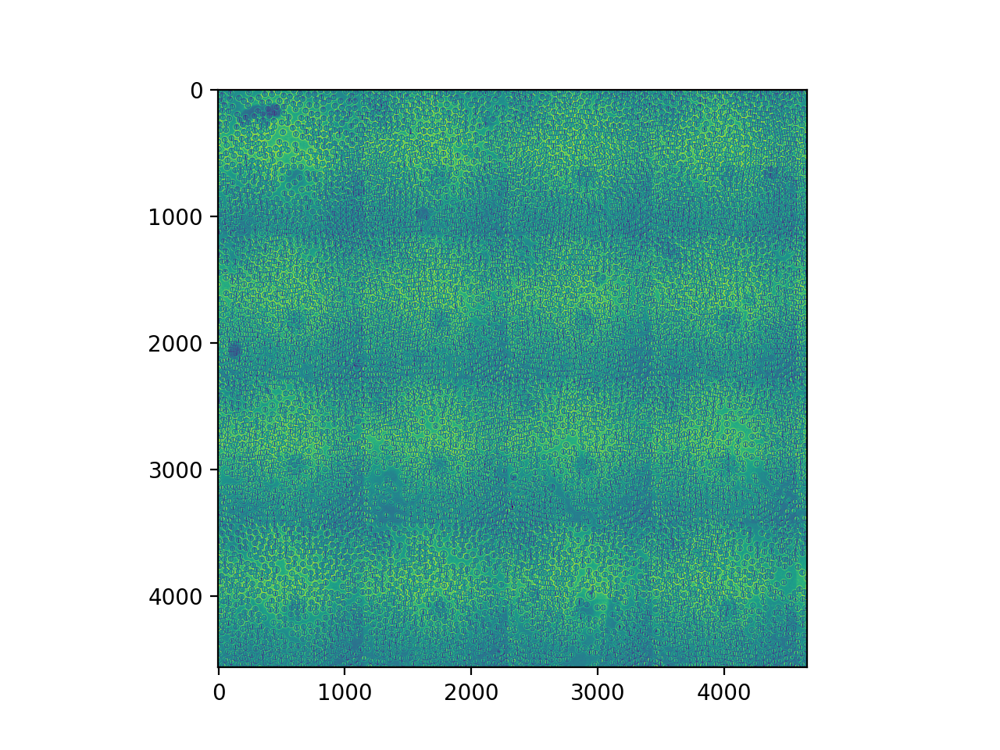

In [19]:
plt.imshow(img_eq)

<IPython.core.display.Javascript object>


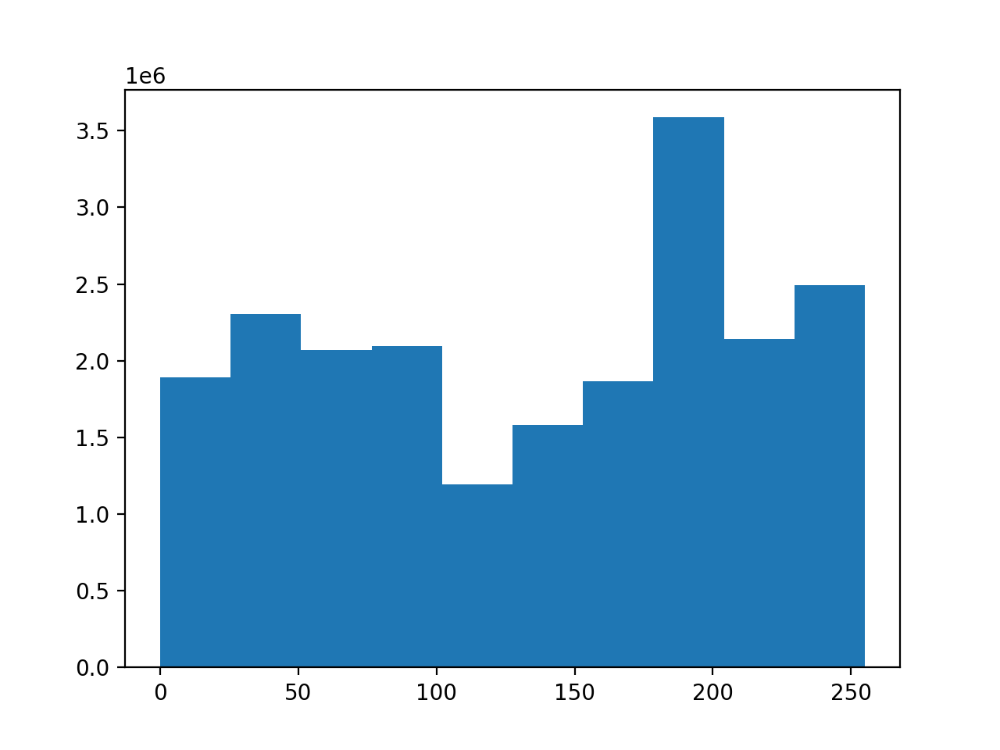

(array([1891141., 2304050., 2072222., 2096621., 1193306., 1580068.,
        1867682., 3586099., 2139279., 2492132.]),
 array([  0. ,  25.5,  51. ,  76.5, 102. , 127.5, 153. , 178.5, 204. ,
        229.5, 255. ]),
 <BarContainer object of 10 artists>)

In [20]:
plt.hist(img_eq.ravel())

### Try patch equalization

In [21]:
patch = new_img_int[:1141,:1141]

<IPython.core.display.Javascript object>


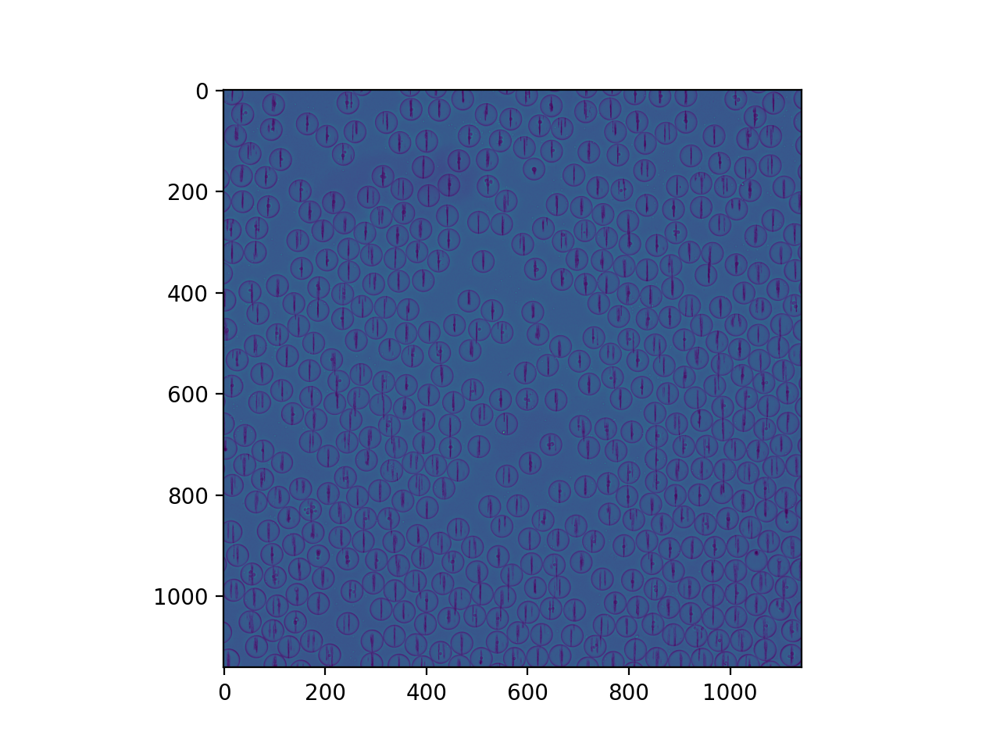

In [22]:
plt.imshow(patch)

In [23]:
patch_eq = cv.equalizeHist(patch)

<IPython.core.display.Javascript object>


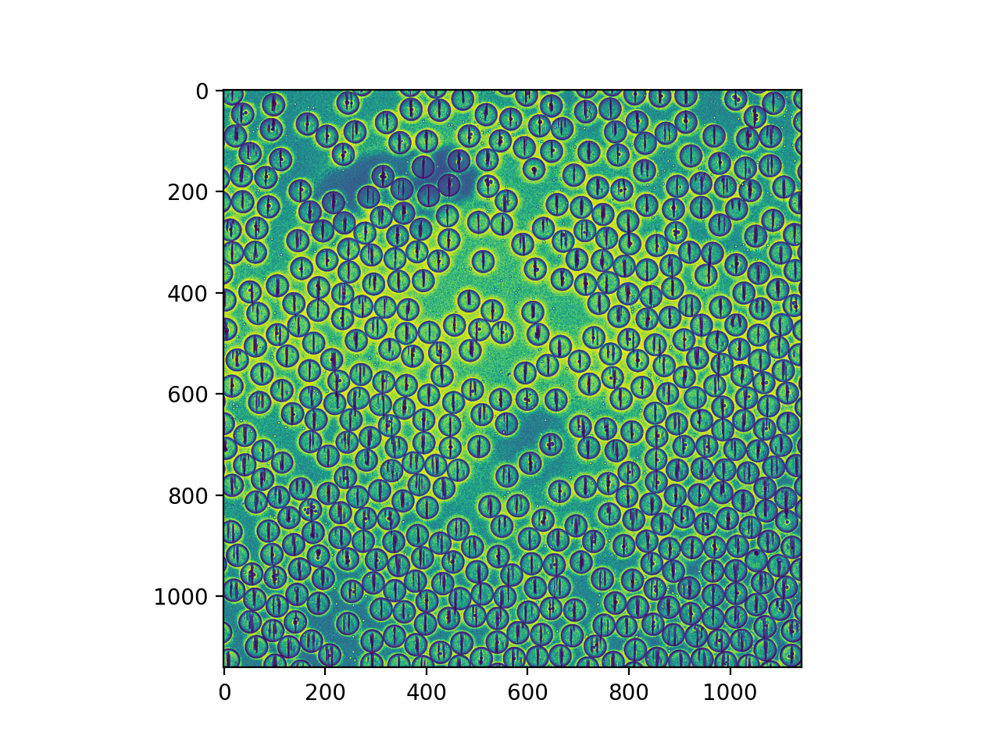

In [24]:
plt.imshow(patch_eq)

---
## Try skimage

In [65]:
img = image[0][4]

In [26]:
# Contrast stretching
p2, p98 = np.percentile(img, (2, 98))
img_rescale = exposure.rescale_intensity(img, in_range=(p2, p98))

<IPython.core.display.Javascript object>


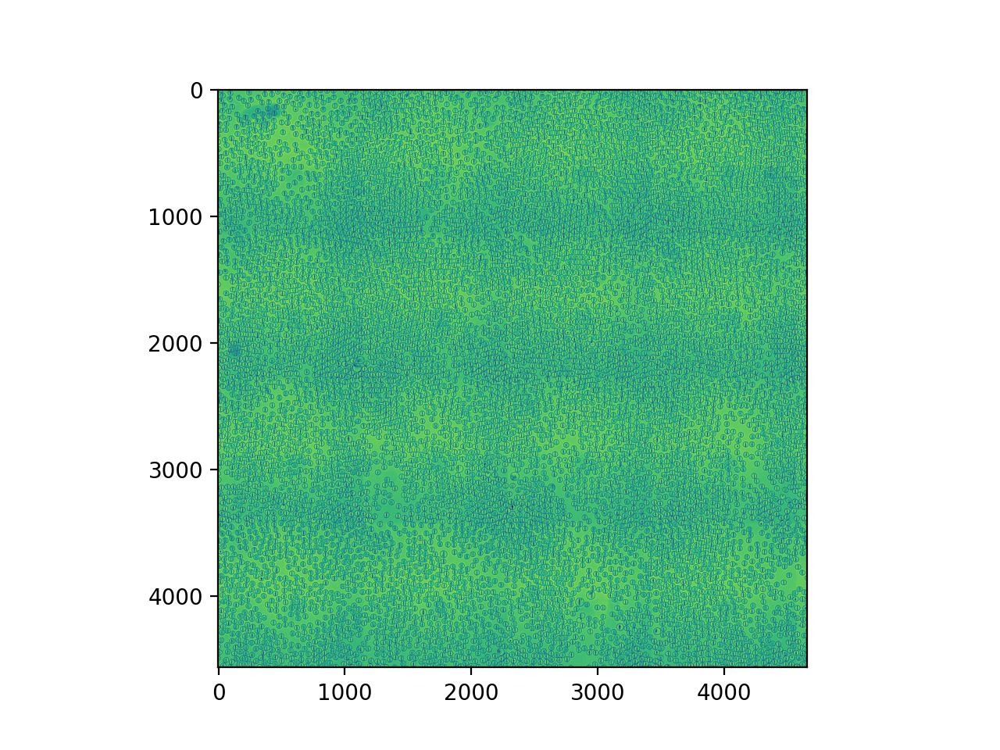

In [27]:
plt.imshow(img_rescale)

In [28]:
# Equalization
img_eq = exposure.equalize_hist(img)

<IPython.core.display.Javascript object>


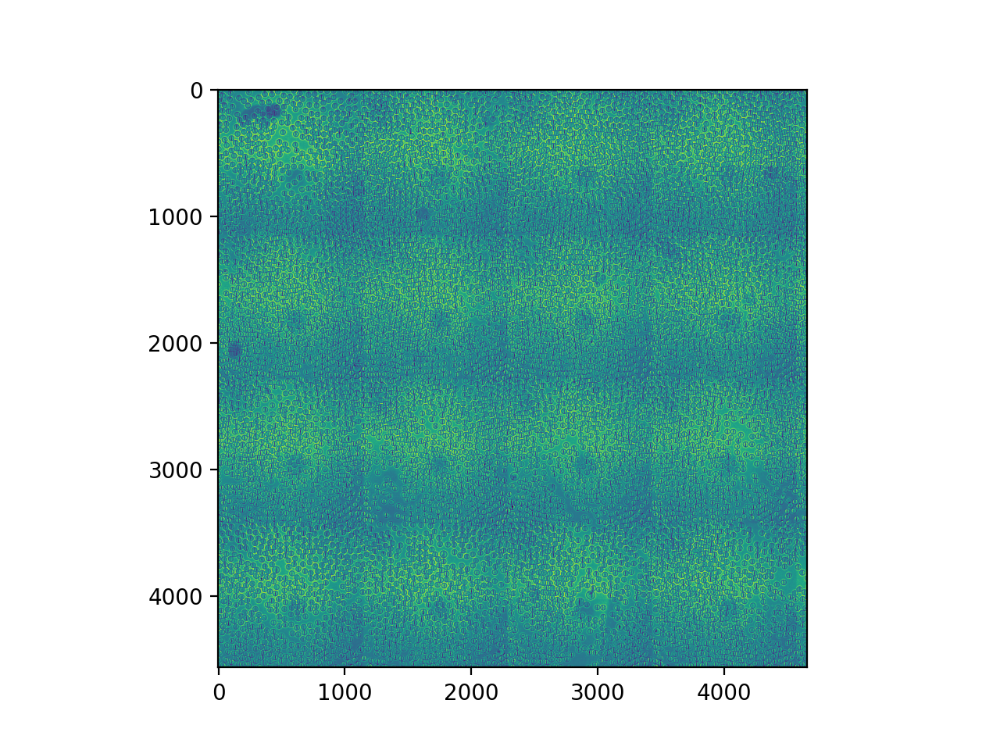

In [29]:
plt.imshow(img_eq)

In [30]:
# Adaptive Equalization
img_adapteq = exposure.equalize_adapthist(img, clip_limit=0.03)

<IPython.core.display.Javascript object>


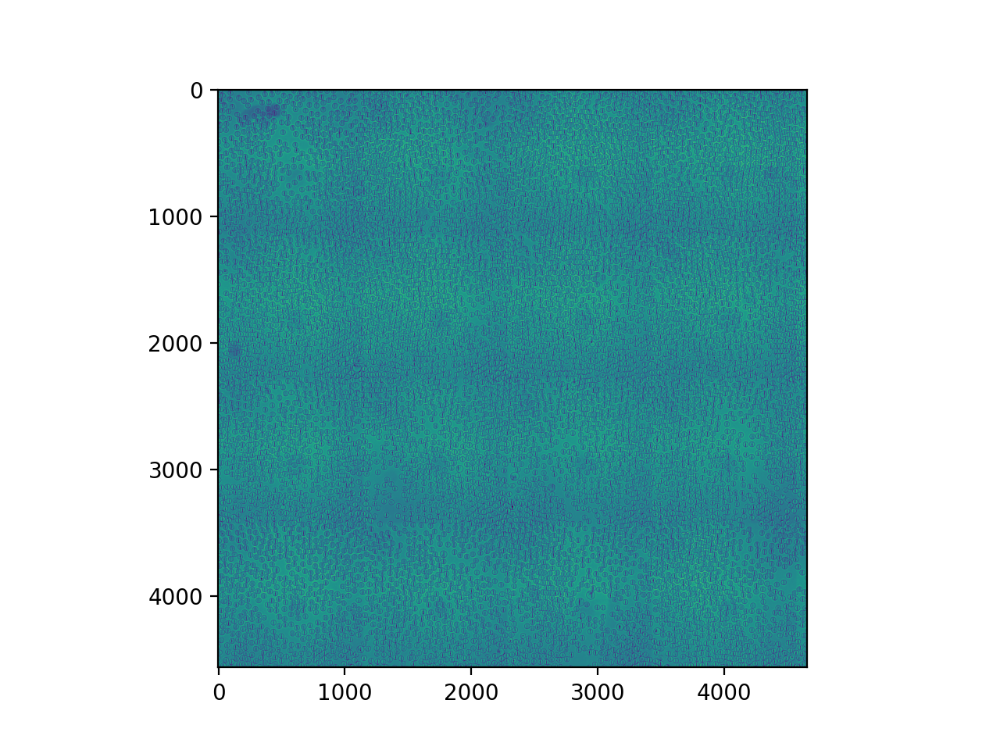

In [31]:
plt.imshow(img_adapteq)

In [66]:
# Local equalization
footprint = disk(30)
img_loc_30_eq = rank.equalize(img, footprint=footprint)

<IPython.core.display.Javascript object>


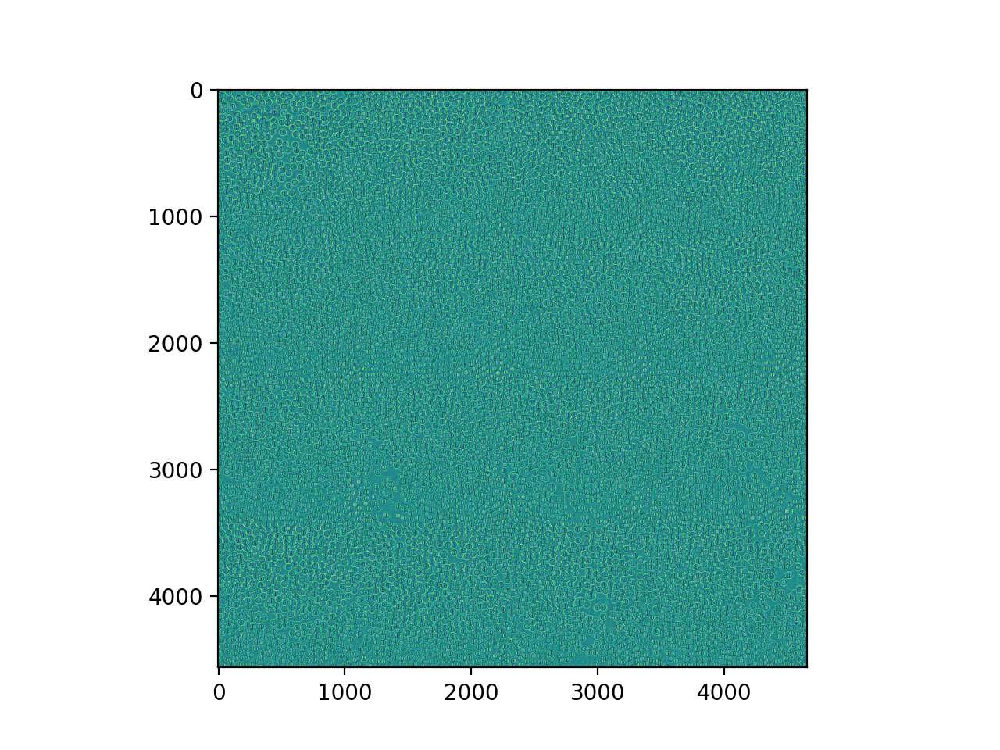

In [67]:
plt.imshow(img_loc_30_eq)

<IPython.core.display.Javascript object>


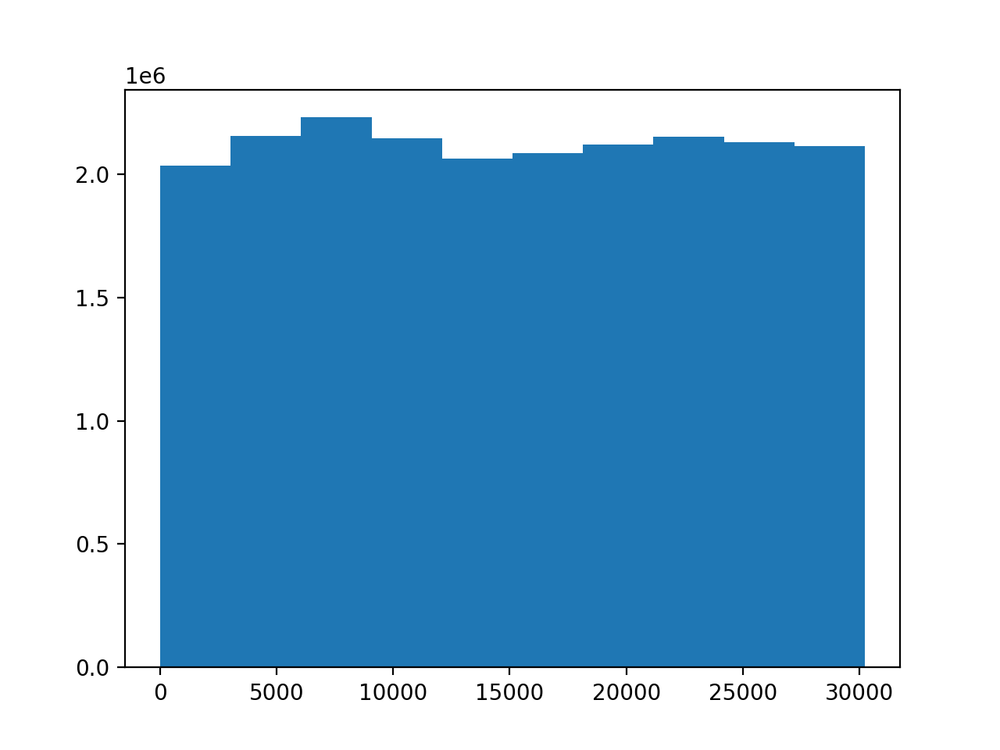

(array([2035352., 2153895., 2228909., 2144175., 2063042., 2083388.,
        2120936., 2151791., 2129482., 2111630.]),
 array([1.00000e+01, 3.03170e+03, 6.05340e+03, 9.07510e+03, 1.20968e+04,
        1.51185e+04, 1.81402e+04, 2.11619e+04, 2.41836e+04, 2.72053e+04,
        3.02270e+04]),
 <BarContainer object of 10 artists>)

In [34]:
plt.hist(img_loc_30_eq.ravel())

In [35]:
# Local equalization
footprint = disk(60)
img_loc_60_eq = rank.equalize(img, footprint=footprint)

<IPython.core.display.Javascript object>


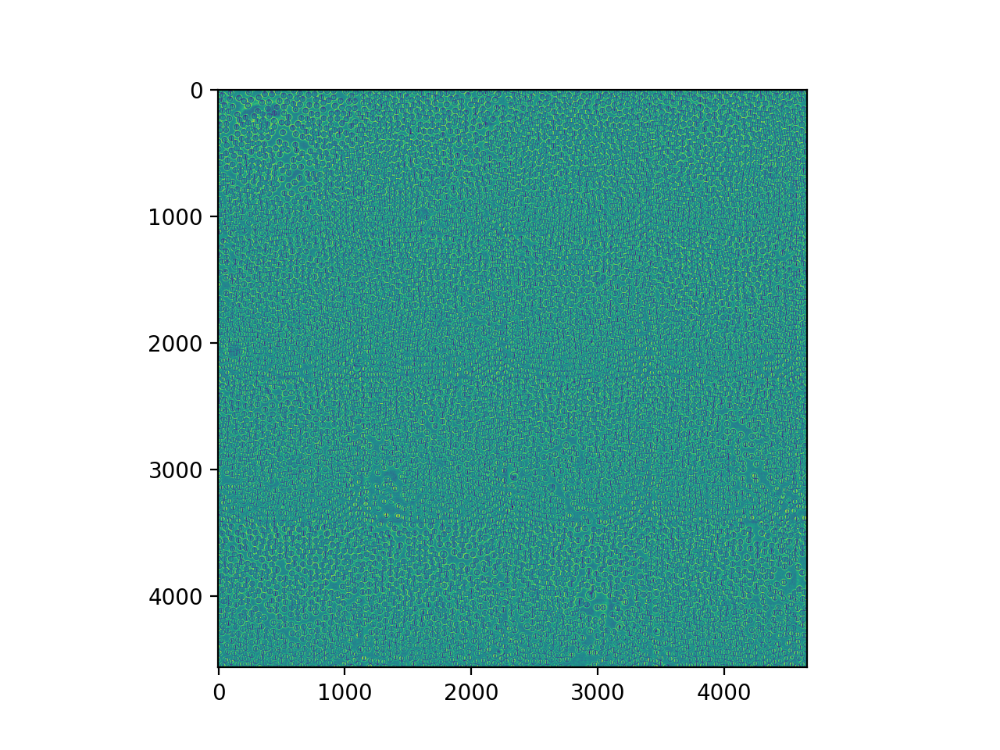

In [36]:
plt.imshow(img_loc_60_eq)

<IPython.core.display.Javascript object>


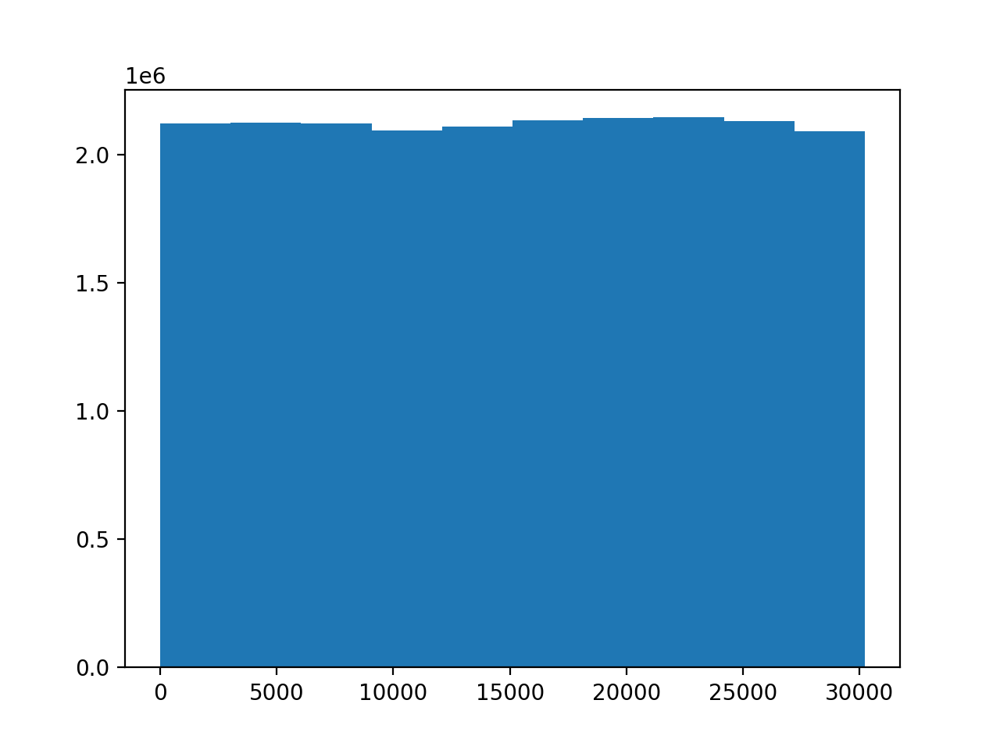

(array([2121100., 2126044., 2122043., 2094224., 2111379., 2133352.,
        2143481., 2145338., 2132722., 2092917.]),
 array([2.00000e+00, 3.02450e+03, 6.04700e+03, 9.06950e+03, 1.20920e+04,
        1.51145e+04, 1.81370e+04, 2.11595e+04, 2.41820e+04, 2.72045e+04,
        3.02270e+04]),
 <BarContainer object of 10 artists>)

In [37]:
plt.hist(img_loc_60_eq.ravel())

---
## Noise removal

In [38]:
img = img_loc_30_eq

<IPython.core.display.Javascript object>


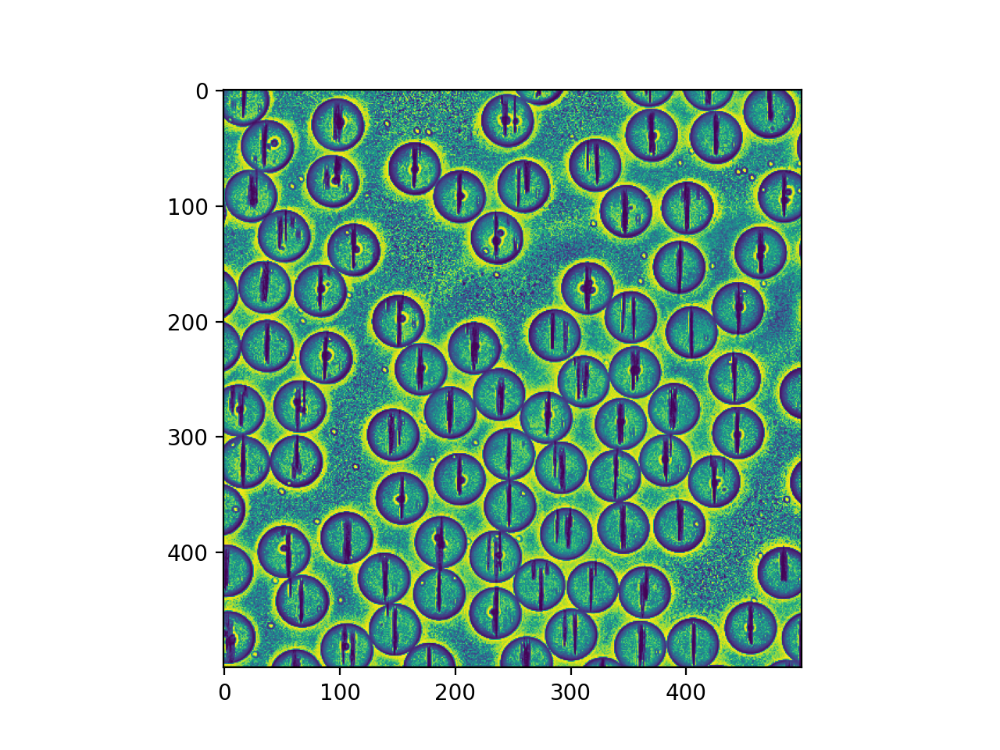

In [39]:
plt.imshow(img[:500, :500])

In [40]:
img_noise_r = [median(img, disk(r)) for r in [1, 2, 5, 10]]

<IPython.core.display.Javascript object>


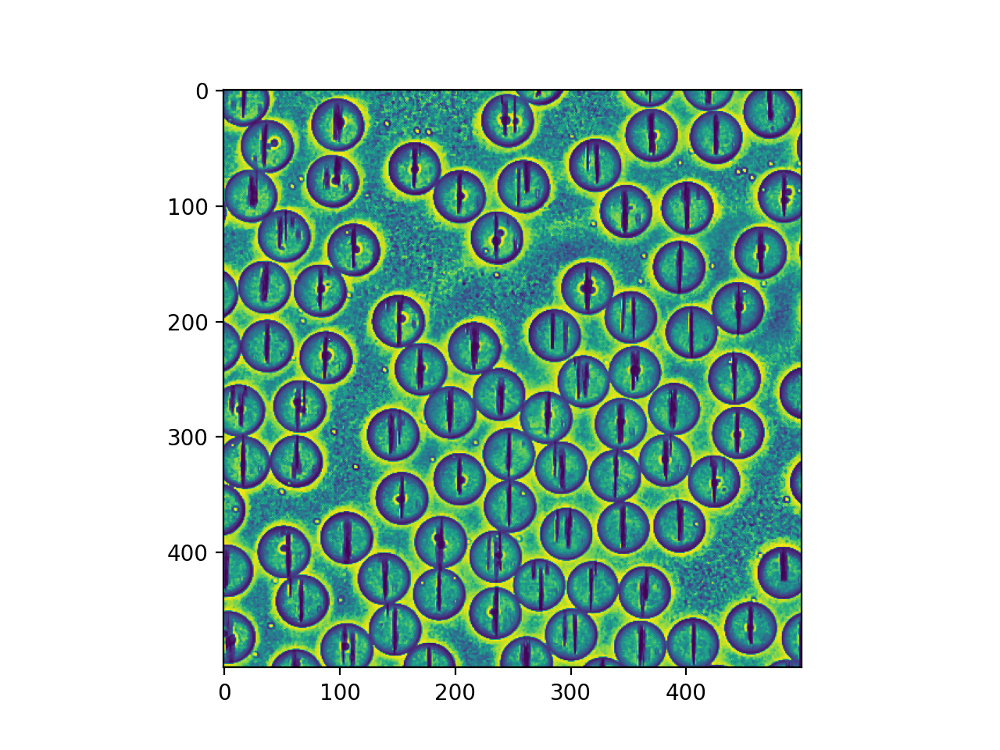

In [41]:
plt.imshow(img_noise_r[0][:500, :500])

<IPython.core.display.Javascript object>


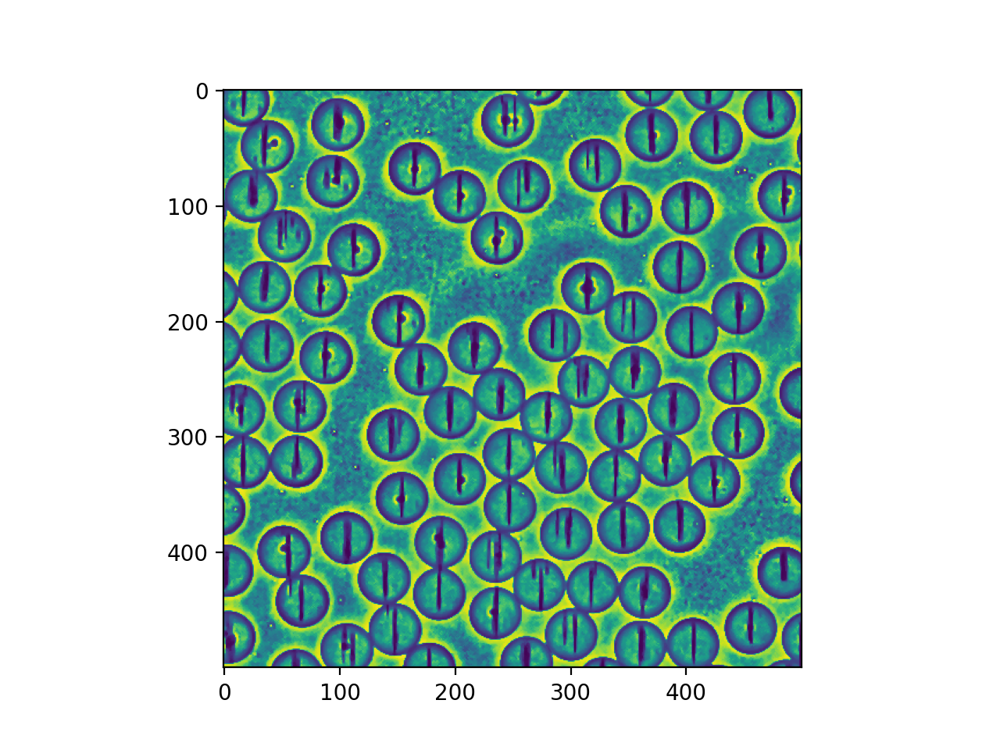

In [42]:
plt.imshow(img_noise_r[1][:500, :500])

<IPython.core.display.Javascript object>


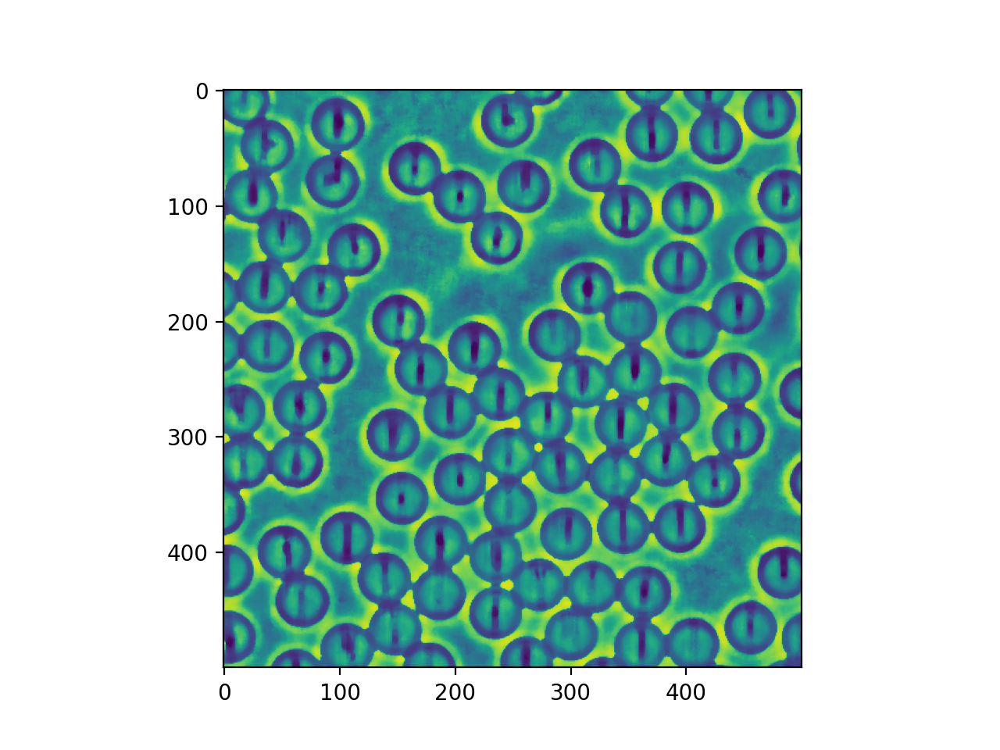

In [43]:
plt.imshow(img_noise_r[2][:500, :500])

<IPython.core.display.Javascript object>


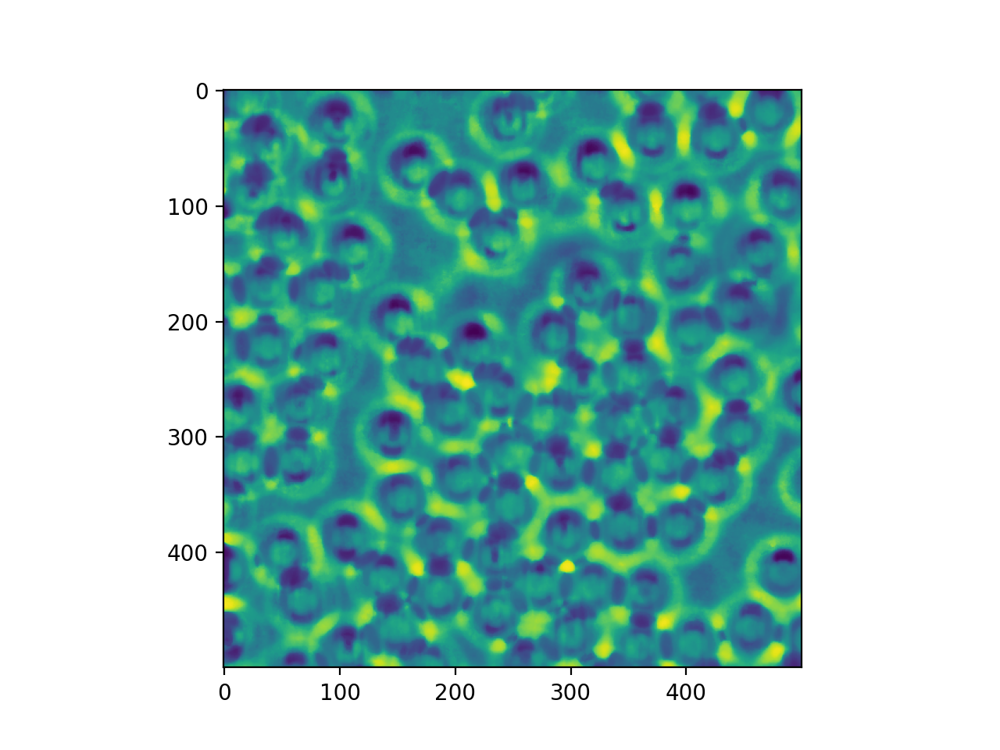

In [44]:
plt.imshow(img_noise_r[3][:500, :500])

In [18]:
img_noise_bilat_20 = mean_bilateral(img, disk(20), s0=10, s1=10)

/Users/antoine/miniconda3/envs/dsl/lib/python3.10/site-packages/skimage/filters/rank/bilateral.py:36: UserWarning: Bad rank filter performance is expected due to a large number of bins (30228), equivalent to an approximate bitdepth of 14.9.
  image, footprint, out, mask, n_bins = _preprocess_input(


<IPython.core.display.Javascript object>


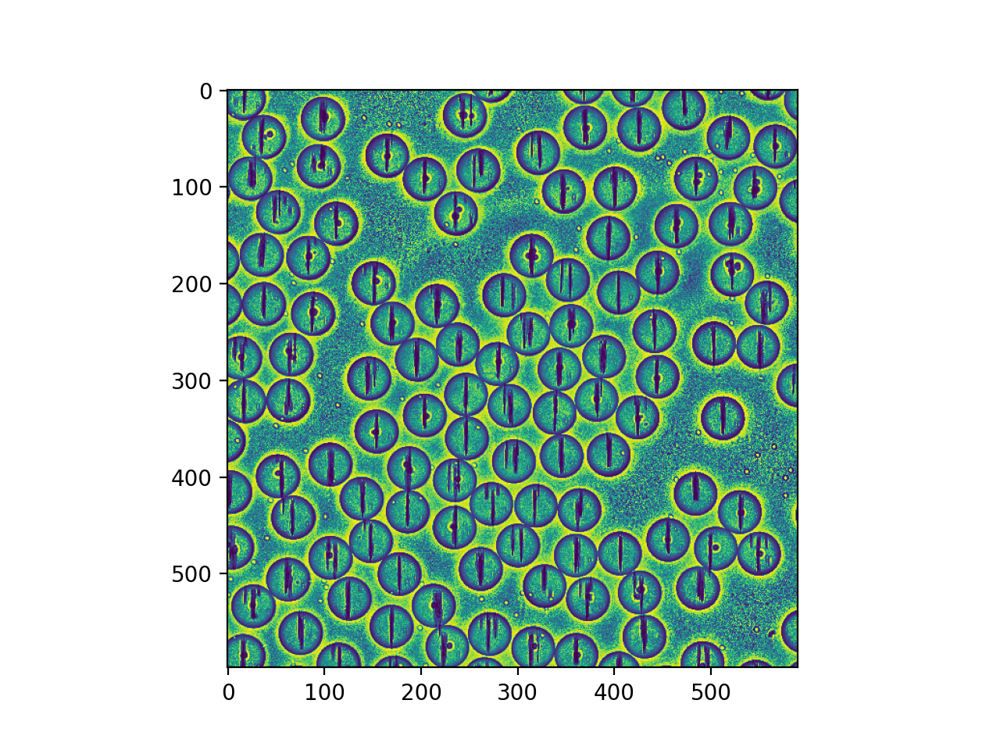

In [19]:
plt.imshow(img_noise_bilat_20)

---
## DAPI

In [68]:
img = image[0][0]

<IPython.core.display.Javascript object>


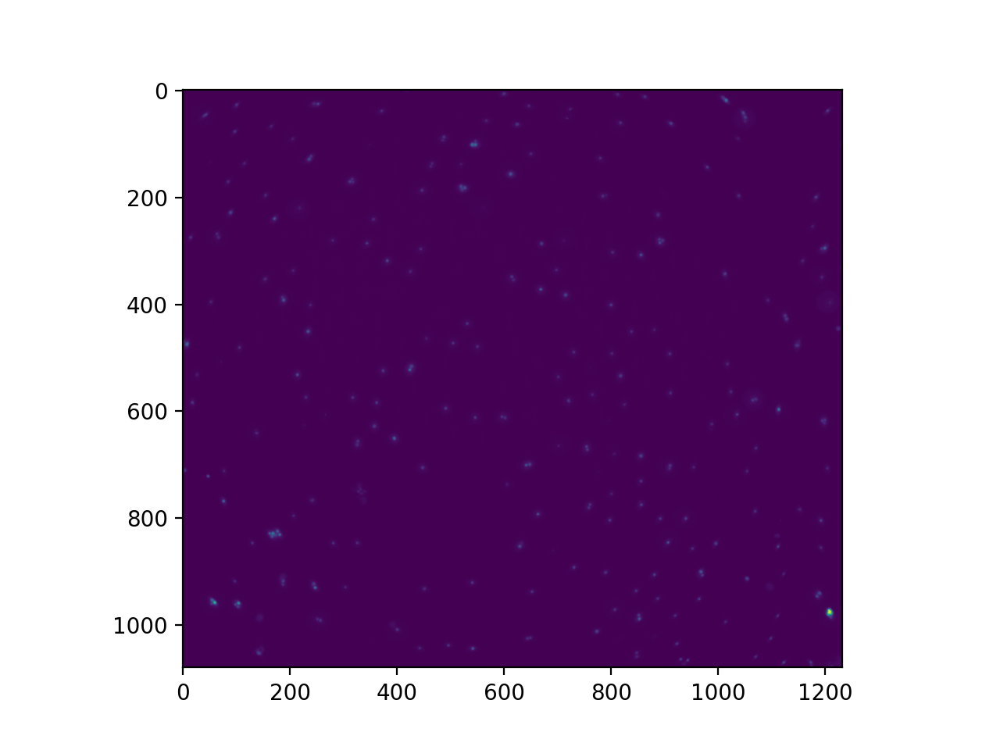

In [69]:
plt.imshow(img)

In [47]:
img_eq = exposure.equalize_hist(img)

<IPython.core.display.Javascript object>


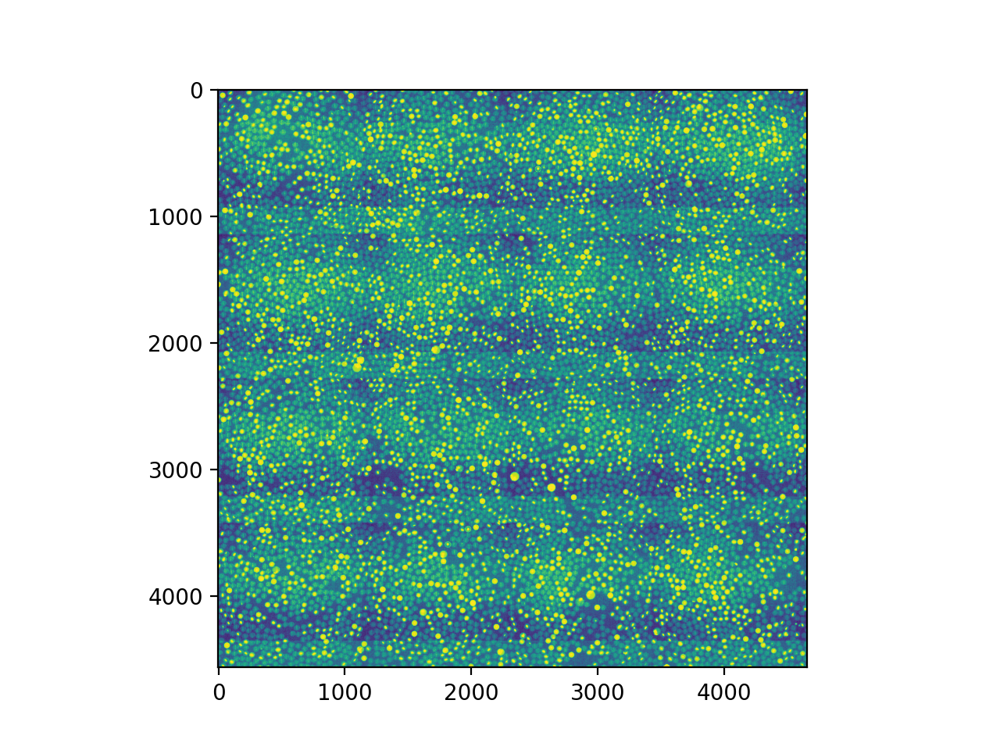

In [48]:
plt.imshow(img_eq)

In [49]:
# Local equalization
footprint = disk(30)
img_loc_30_eq = rank.equalize(img, footprint=footprint)

/Users/antoine/miniconda3/envs/dsl/lib/python3.10/site-packages/skimage/filters/rank/generic.py:262: UserWarning: Bad rank filter performance is expected due to a large number of bins (65536), equivalent to an approximate bitdepth of 16.0.
  image, footprint, out, mask, n_bins = _preprocess_input(image, footprint,


<IPython.core.display.Javascript object>


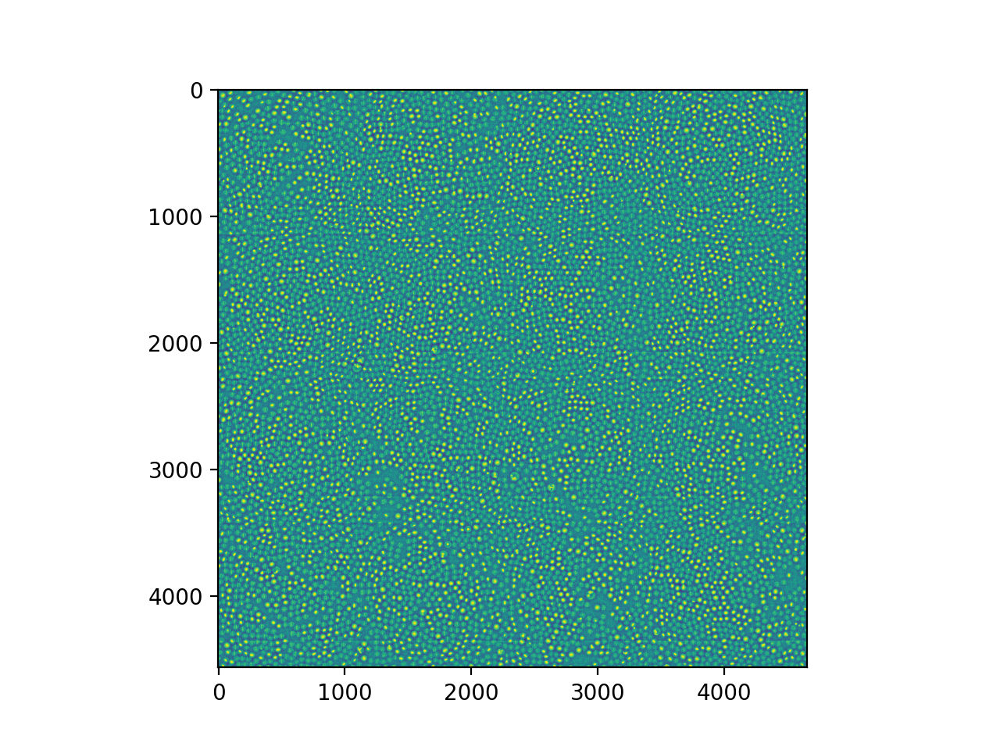

In [50]:
plt.imshow(img_loc_30_eq)

In [70]:
# Local equalization
footprint = disk(5)
img_loc_5_eq = rank.equalize(img, footprint=footprint)

<IPython.core.display.Javascript object>


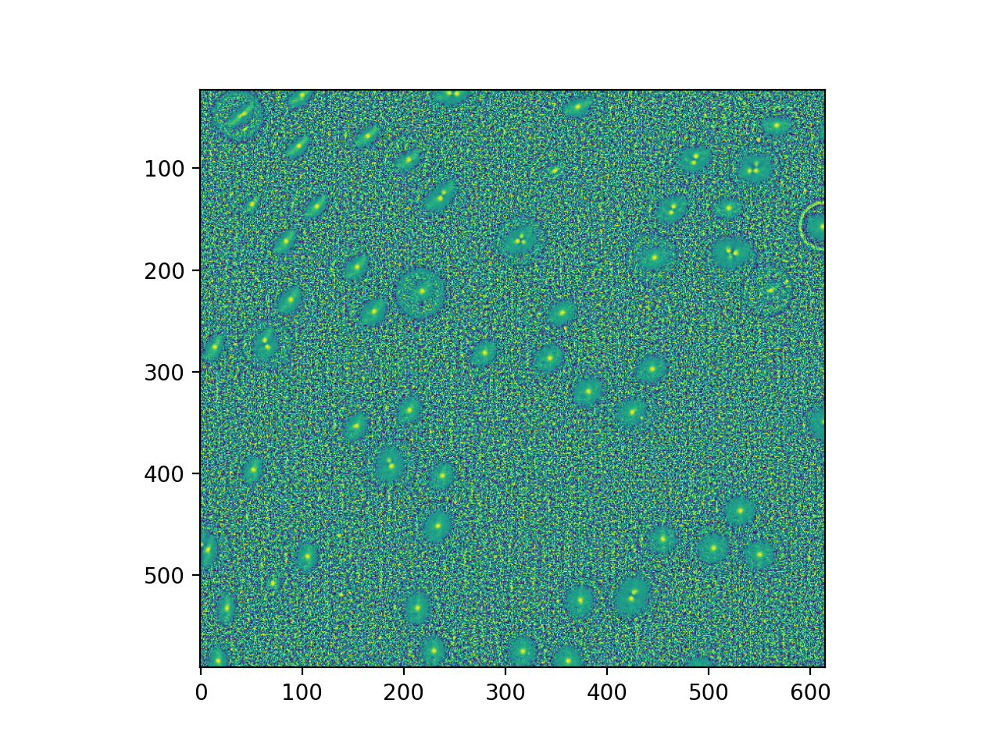

In [71]:
plt.imshow(img_loc_5_eq)

### Filtering regional maxima

In [72]:
img = img_loc_5_eq

In [73]:
img = img_as_float(img)
img = gaussian_filter(img, 1)

seed = np.copy(img)
seed[1:-1, 1:-1] = img.min()
mask = img

dilated = reconstruction(seed, mask, method='dilation')

<IPython.core.display.Javascript object>


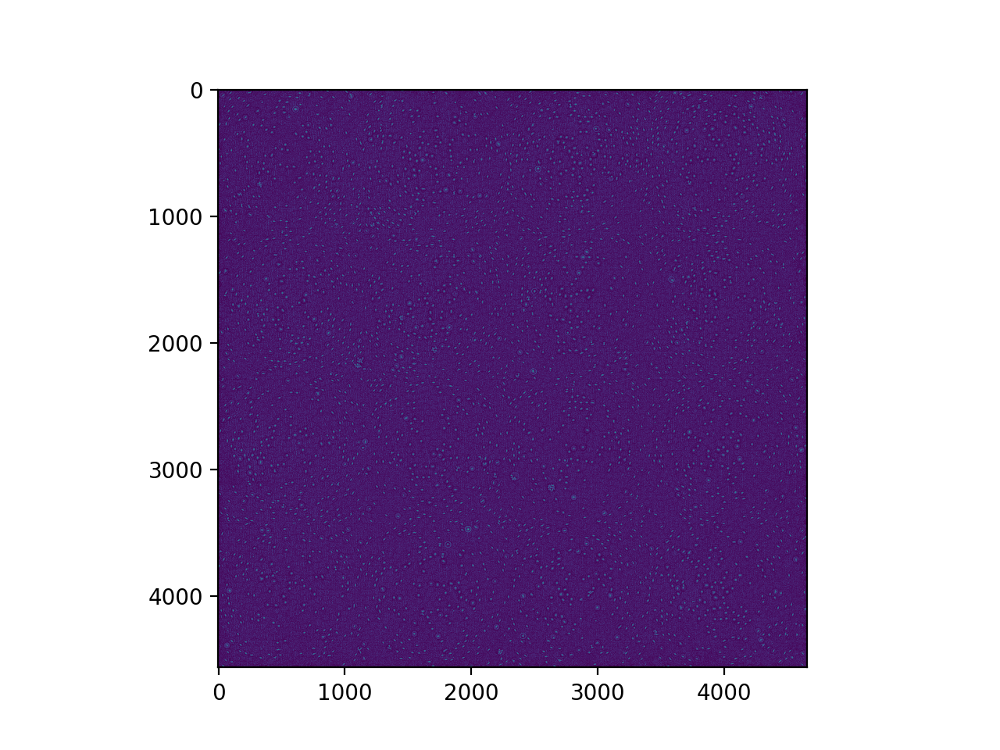

In [74]:
plt.imshow(img - dilated)

### Removing Noise

In [56]:
img = img - dilated

<IPython.core.display.Javascript object>


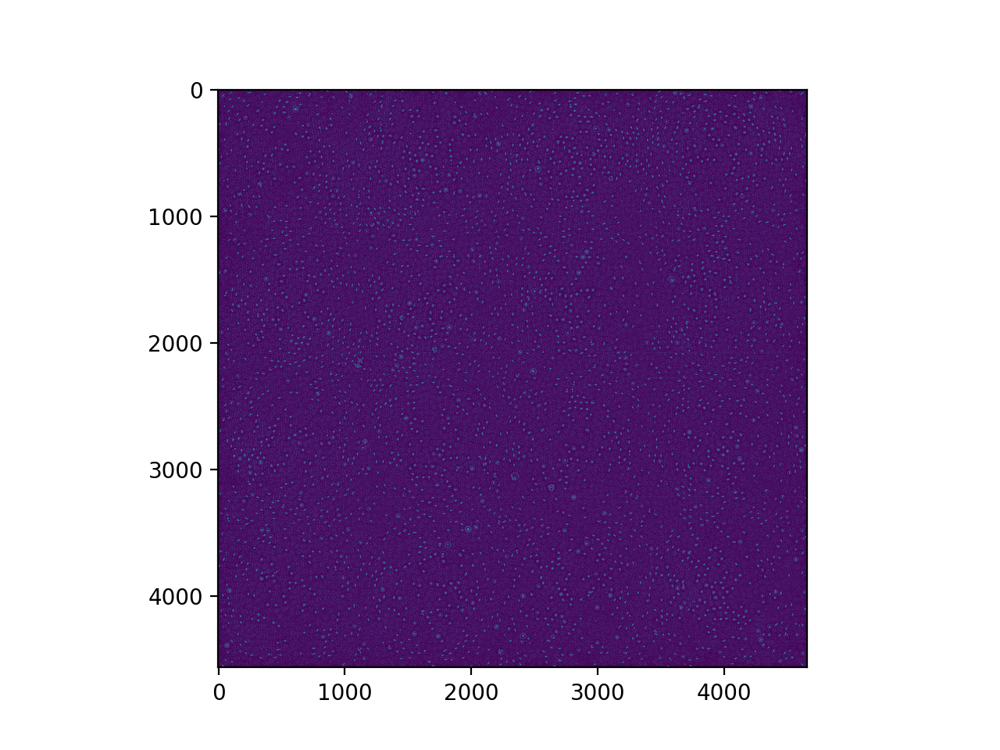

In [57]:
plt.imshow(median(img, disk(2)))

<IPython.core.display.Javascript object>


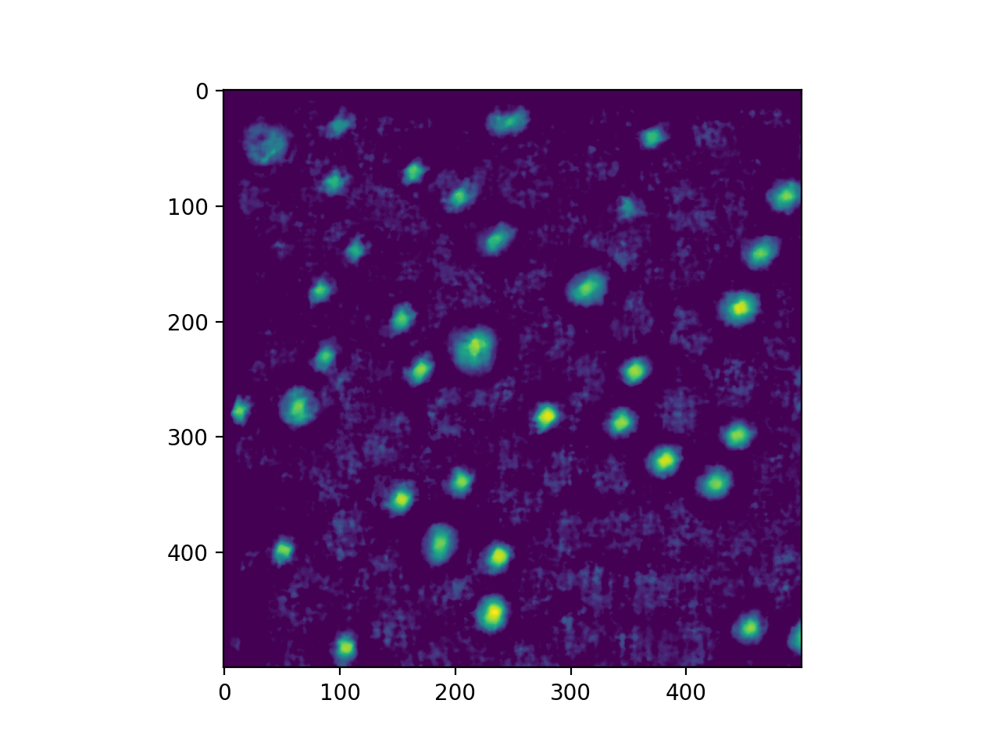

In [58]:
plt.imshow(median(img, disk(10))[:500,:500])

In [59]:
footprint = morphology.disk(1)
res = morphology.white_tophat(img, footprint)

<IPython.core.display.Javascript object>


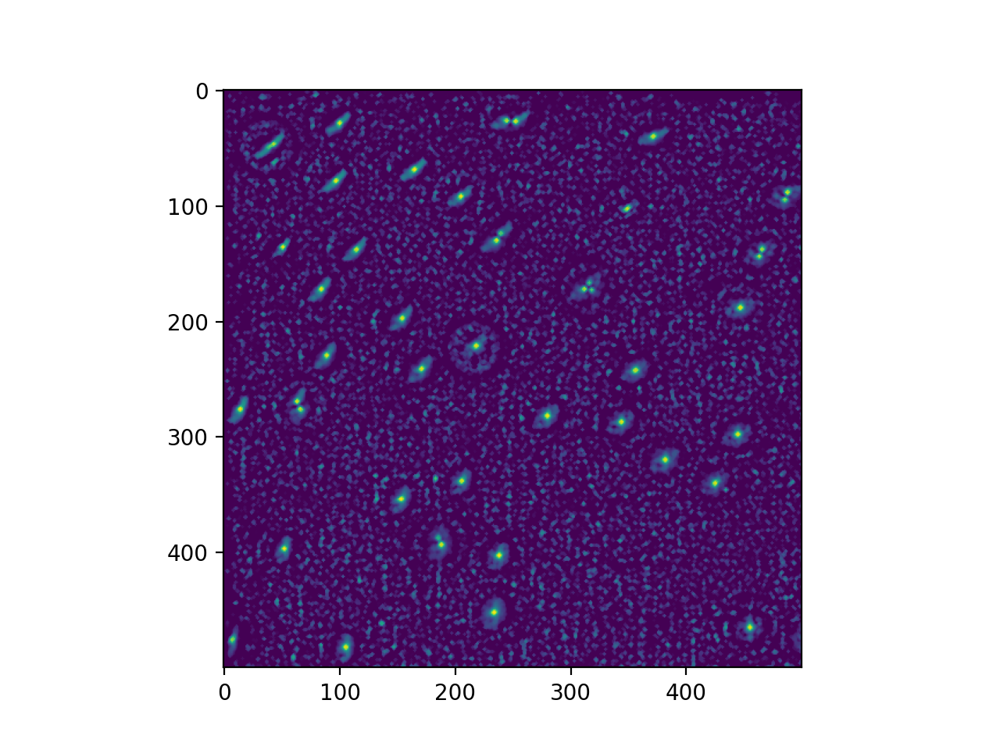

In [60]:
plt.imshow((img - res)[:500,:500])

In [61]:
footprint = morphology.disk(2)
res = morphology.white_tophat(img, footprint)

<IPython.core.display.Javascript object>


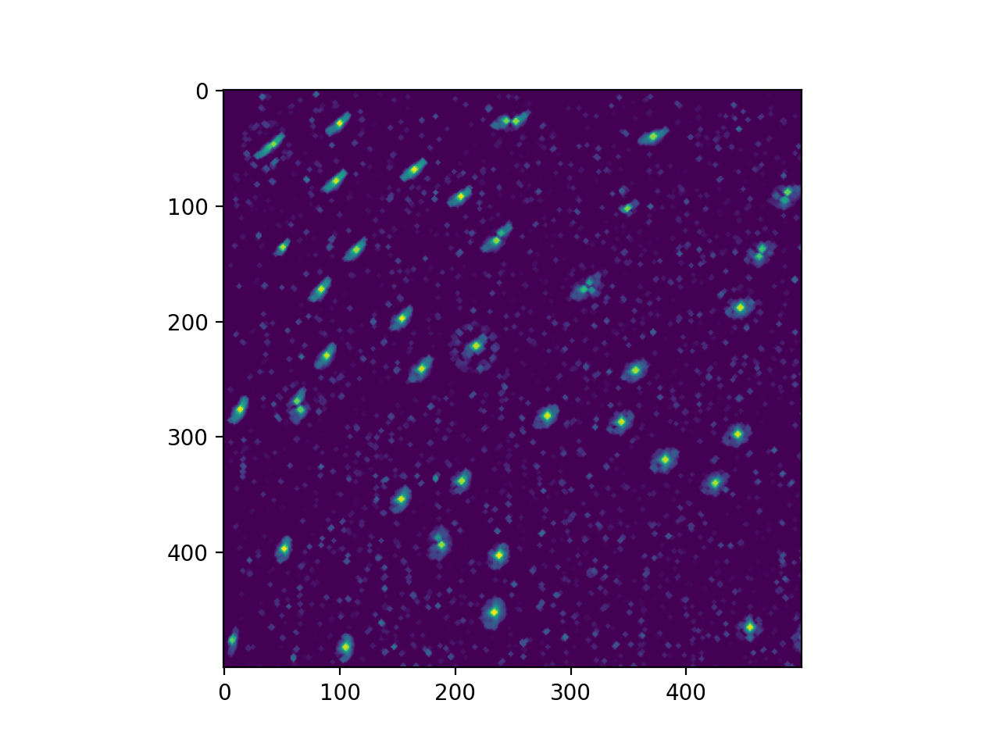

In [62]:
plt.imshow((img - res)[:500,:500])

---
#### TO INVESTIGATE
https://scikit-image.org/docs/stable/auto_examples/registration/plot_opticalflow.html#sphx-glr-auto-examples-registration-plot-opticalflow-py